In [10]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
import folium
warnings.filterwarnings("ignore")

## Preprocessing

In [15]:
# import dataset
df = pd.read_csv('../train_data.csv', index_col='GEOID').drop(columns = 'Unnamed: 0')
df.index = df.index.astype(int).astype(str)
df.head()


,attr_cnt_1mile,attr_cnt_5mile,distance_to_nearest_attr,crime_population,violent_crime,murder_nonnegligent_manslaughter,Rape1,Robbery,aggravated_assault,property_crime,...,traff_cnt_10m_max,traff_cnt_5m_avg,traff_cnt_5m_max,ev_cnt,attr_cnt,traffic_cnt,traffic_max,traffic_avg,geometry,category
GEOID,,,,,,,,,,,,,,,,,,,,,
53001950100,0.0,0.0,2.461667,10033.000000,8.000000,0.000000,3.000000,1.000000,4.000000,202.000000,...,21000.0,7060.760177,21000.0,4.0,0.0,60.0,21000.0,6340.833333,0.192617,0
53001950200,0.0,0.0,2.461667,10033.000000,8.000000,0.000000,3.000000,1.000000,4.000000,202.000000,...,9400.0,3745.555556,9400.0,0.0,0.0,37.0,12000.0,2252.162162,0.310769,0
53001950500,0.0,0.0,2.300410,10033.000000,8.000000,0.000000,3.000000,1.000000,4.000000,202.000000,...,9500.0,6100.000000,9500.0,0.0,0.0,6.0,9500.0,7083.333333,0.001465,2
53003960100,0.0,0.0,2.461667,157688.628472,580.513889,4.607639,75.375000,154.857639,345.673611,5547.500000,...,25000.0,4713.000000,8300.0,0.0,1.0,8.0,4900.0,1561.250000,0.157066,0
53003960300,0.0,0.0,2.300410,757877.521823,2850.672657,21.649551,329.789474,857.874198,1641.359435,27469.935815,...,25000.0,7318.214286,25000.0,1.0,0.0,13.0,25000.0,9792.307692,0.000532,2


<AxesSubplot:title={'center':'Correlation Matrix Before Feature Selection\n'}>

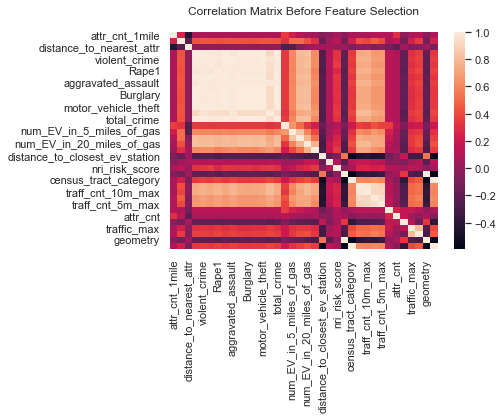

In [16]:
sns.set(font_scale=1)
plt.title('Correlation Matrix Before Feature Selection\n')
sns.heatmap(df.corr())

In [17]:
df = df.drop(columns=['violent_crime',
       'murder_nonnegligent_manslaughter', 'Rape1', 'Robbery',
       'aggravated_assault', 'property_crime', 'Burglary',
       'larceny_theft', 'motor_vehicle_theft', 'Arson', 'crime_population',
       'traff_cnt_10m_avg', 'traff_cnt_10m_max', 'traff_cnt_5m_max', 'traffic_cnt',
       'num_EV_in_2_miles_of_gas', 'num_EV_in_5_miles_of_gas',
       'num_EV_in_10_miles_of_gas', 'num_EV_in_20_miles_of_gas',
       'num_EV_in_50_miles_of_gas', 'census_tract_area', 'census_tract_category', 'traffic_max'])

<AxesSubplot:title={'center':'Correlation Matrix After Feature Selection\n'}>

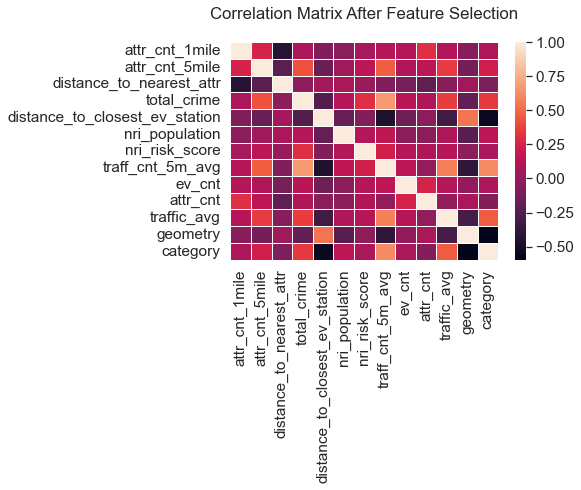

In [18]:
sns.set(font_scale=1.4)
plt.title('Correlation Matrix After Feature Selection\n')
sns.heatmap(df.corr(), linewidth=.5)

## Method 1: rural area as test set, train on urban and suburban area, no finetune

(907, 12) (138, 12)


<AxesSubplot:>

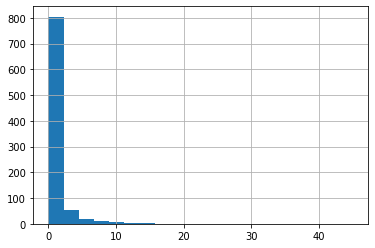

In [40]:
# rural area as test set, train on urban and suburban area
X_train = df.loc[(df.category == 2) | (df.category == 1)].drop(columns = 'ev_cnt')
y_train = df.loc[(df.category == 2) | (df.category == 1)].ev_cnt
X_test = df.loc[df.category == 0].drop(columns = 'ev_cnt')
y_test = df.loc[df.category == 0].ev_cnt
print(X_train.shape, X_test.shape)
y_train.hist(bins=20)

## Method 2: Pretrained on urban or non-zero areas, make predictions on the other

<AxesSubplot:>

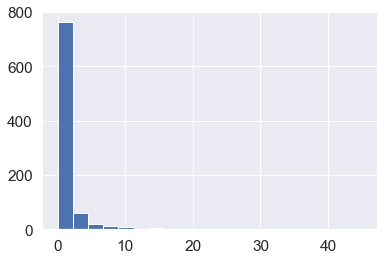

In [19]:
df_train  = df[(df.ev_cnt != 0) | (df.category == 2)]
df_pred = df.drop(index=df_train.index)
df_train.ev_cnt.hist(bins=20)

In [20]:
from sklearn.model_selection import train_test_split
X = df_train.drop(columns=['ev_cnt', 'category'])
y = df_train.ev_cnt
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.33, random_state=2)
X_test = df_pred.drop(columns=['ev_cnt', 'category'])
y_test = df_pred.ev_cnt
print(X_train.shape, X_val.shape, X_test.shape)

(585, 11) (289, 11) (171, 11)


In [21]:
# test gamma distribution
from scipy import stats
stats.kstest(y, 'gamma', (15.5, 0))

KstestResult(statistic=0.9688042227560312, pvalue=0.0)

## Baseline Model Training

### Random Forest

training score:  0.7334712564138247
validate score:  0.4405548186502134


array([[<AxesSubplot:title={'center':'0'}>]], dtype=object)

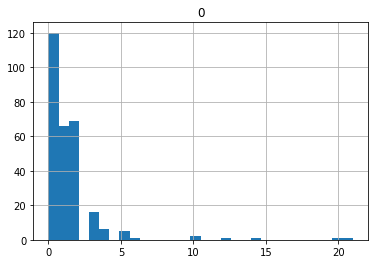

In [18]:
from sklearn.ensemble import RandomForestRegressor
reg = RandomForestRegressor(n_estimators=500, random_state=42, max_depth=5)
reg.fit(X_train, y_train)
y_pred = reg.predict(X_val)
print("training score: ", reg.score(X_train, y_train))
print("validate score: ", reg.score(X_val, y_val))
pd.DataFrame(y_pred.round()).hist(bins=30)

In [27]:
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import KFold
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV
import warnings
warnings.filterwarnings('ignore')
# A parameter grid for Random Forest
params = {
        'max_depth': [3, 4, 5],
        'n_estimators': [200, 500]
        }

folds = 5
param_comb = 5
reg = RandomForestRegressor()

kf = KFold(n_splits=folds, shuffle = True, random_state = 42)

random_search = RandomizedSearchCV(reg, param_distributions=params, n_iter=param_comb, n_jobs=4, cv= kf.split(X,y), verbose=0, random_state=42 )

# Here we go
# start_time = timer(None) # timing starts from this point for "start_time" variable
random_search.fit(X, y)
# timer(start_time) # timing ends here for "start_time" variable

# print('\n All results:')
# print(random_search.cv_results_)
print('\n Best estimator:')
print(random_search.best_estimator_)
print('\n Best score:')
print(random_search.best_score_ )
print('\n Best hyperparameters:')
print(random_search.best_params_)
results = pd.DataFrame(random_search.cv_results_)


 Best estimator:
RandomForestRegressor(max_depth=3, n_estimators=200)

 Best score:
0.18310443241036534

 Best hyperparameters:
{'n_estimators': 200, 'max_depth': 3}


In [32]:
y_pred = random_search.predict(X_val).round()
print("training set mean squared error: ", mean_squared_error(y_pred=random_search.predict(X_train), y_true=y_train).round(4))
print("validation set mean squared error: ", mean_squared_error(y_pred=y_pred, y_true=y_val).round(4))
print("training set r2_score: ", r2_score(y_pred=random_search.predict(X_train), y_true=y_train).round(4))
print("validation set r2_score: ", r2_score(y_pred=y_pred, y_true=y_val).round(4))

training set mean squared error:  5.8351
validation set mean squared error:  3.3114
training set r2_score:  0.4222
validation set r2_score:  0.5937


In [28]:
# random_search.best_estimator_.save_model("rf_best_.txt")

AttributeError: 'RandomForestRegressor' object has no attribute 'save_model'

### Linear Regression

training score:  0.06878425937400356
validate score:  0.12330151080282481


array([[<AxesSubplot:title={'center':'0'}>]], dtype=object)

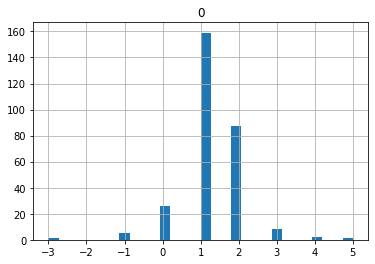

In [20]:
from sklearn.linear_model import LinearRegression
lin_reg = LinearRegression()
lin_reg.fit(X_train, y_train)
y_pred = lin_reg.predict(X_val)

print("training score: ", lin_reg.score(X_train, y_train))
print("validate score: ", lin_reg.score(X_val, y_val))
pd.DataFrame(y_pred.round()).hist(bins=30)

In [36]:
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import KFold
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV
import warnings
warnings.filterwarnings('ignore')
# A parameter grid for Random Forest
params = {}

folds = 5
param_comb = 5
reg = LinearRegression()

kf = KFold(n_splits=folds, shuffle = True, random_state = 42)

random_search = RandomizedSearchCV(reg, param_distributions=params, n_iter=param_comb, n_jobs=4, cv= kf.split(X,y), verbose=0, random_state=42 )

# Here we go
# start_time = timer(None) # timing starts from this point for "start_time" variable
random_search.fit(X, y)
# timer(start_time) # timing ends here for "start_time" variable

# print('\n All results:')
# print(random_search.cv_results_)
print('\n Best estimator:')
print(random_search.best_estimator_)
print('\n Best score:')
print(random_search.best_score_ )
print('\n Best hyperparameters:')
print(random_search.best_params_)
results = pd.DataFrame(random_search.cv_results_)


 Best estimator:
LinearRegression()

 Best score:
-0.04673083032047933

 Best hyperparameters:
{}


In [37]:
y_pred = random_search.predict(X_val).round()
print("training set mean squared error: ", mean_squared_error(y_pred=random_search.predict(X_train), y_true=y_train).round(4))
print("validation set mean squared error: ", mean_squared_error(y_pred=y_pred, y_true=y_val).round(4))
print("training set r2_score: ", r2_score(y_pred=random_search.predict(X_train), y_true=y_train).round(4))
print("validation set r2_score: ", r2_score(y_pred=y_pred, y_true=y_val).round(4))

training set mean squared error:  9.5581
validation set mean squared error:  6.4948
training set r2_score:  0.0535
validation set r2_score:  0.2032


### Gamma regressor

training score:  1.1102230246251565e-16
validate score:  -0.0005017808560949799


array([[<AxesSubplot:title={'center':'0'}>]], dtype=object)

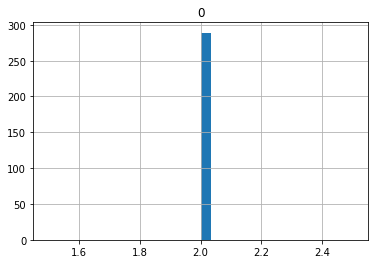

In [23]:
from sklearn.linear_model import GammaRegressor
ga_reg = GammaRegressor()
y_train_shift = y_train+1
ga_reg.fit(X_train, y_train_shift)
y_pred = ga_reg.predict(X_val)
y_val_shift = y_val+1

print("training score: ", ga_reg.score(X_train, y_train_shift))
print("validate score: ", ga_reg.score(X_val, y_val_shift))
pd.DataFrame(y_pred.round()).hist(bins=30)

In [38]:
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import KFold
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV
import warnings
warnings.filterwarnings('ignore')
# A parameter grid for Random Forest
params = {'alpha':[0, 1, 1.5, 2],
        'max_iter':[100, 200]
    }

folds = 5
param_comb = 5
reg = GammaRegressor()

kf = KFold(n_splits=folds, shuffle = True, random_state = 42)

random_search = RandomizedSearchCV(reg, param_distributions=params, n_iter=param_comb, n_jobs=4, cv= kf.split(X,y+1), verbose=0, random_state=42 )

# Here we go
# start_time = timer(None) # timing starts from this point for "start_time" variable
random_search.fit(X, y+1)
# timer(start_time) # timing ends here for "start_time" variable

# print('\n All results:')
# print(random_search.cv_results_)
print('\n Best estimator:')
print(random_search.best_estimator_)
print('\n Best score:')
print(random_search.best_score_ )
print('\n Best hyperparameters:')
print(random_search.best_params_)
results = pd.DataFrame(random_search.cv_results_)


 Best estimator:
GammaRegressor(alpha=0, max_iter=200)

 Best score:
-0.036189928325294794

 Best hyperparameters:
{'max_iter': 200, 'alpha': 0}


/Users/clarissarjtai/miniforge3/lib/python3.8/site-packages/sklearn/linear_model/_glm/link.py:90: RuntimeWarning: overflow encountered in exp
  return np.exp(lin_pred)
/Users/clarissarjtai/miniforge3/lib/python3.8/site-packages/sklearn/linear_model/_glm/link.py:93: RuntimeWarning: overflow encountered in exp
  return np.exp(lin_pred)
/Users/clarissarjtai/miniforge3/lib/python3.8/site-packages/sklearn/_loss/glm_distribution.py:247: RuntimeWarning: overflow encountered in power
  return np.power(y_pred, self.power)
/Users/clarissarjtai/miniforge3/lib/python3.8/site-packages/sklearn/_loss/glm_distribution.py:132: RuntimeWarning: invalid value encountered in true_divide
  return -2 * (y - y_pred) / self.unit_variance(y_pred)
/Users/clarissarjtai/miniforge3/lib/python3.8/site-packages/sklearn/linear_model/_glm/link.py:90: RuntimeWarning: overflow encountered in exp
  return np.exp(lin_pred)
/Users/clarissarjtai/miniforge3/lib/python3.8/site-packages/sklearn/linear_model/_glm/link.py:93: Run

In [39]:
y_pred = random_search.predict(X_val).round()
print("training set mean squared error: ", mean_squared_error(y_pred=random_search.predict(X_train), y_true=y_train).round(4))
print("validation set mean squared error: ", mean_squared_error(y_pred=y_pred, y_true=y_val).round(4))
print("training set r2_score: ", r2_score(y_pred=random_search.predict(X_train), y_true=y_train).round(4))
print("validation set r2_score: ", r2_score(y_pred=y_pred, y_true=y_val).round(4))

training set mean squared error:  11.0718
validation set mean squared error:  8.7197
training set r2_score:  -0.0964
validation set r2_score:  -0.0698


### ElasticNet

training score:  0.016548172315534737
validate score:  -0.002585807071142865


array([[<AxesSubplot:title={'center':'0'}>]], dtype=object)

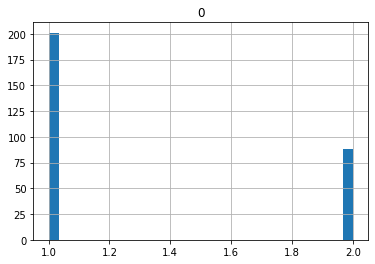

In [25]:
from sklearn.linear_model import ElasticNetCV
en_reg = ElasticNetCV(cv=5, random_state=0)
en_reg.fit(X_train, y_train)
y_pred = en_reg.predict(X_val)

print("training score: ", en_reg.score(X_train, y_train))
print("validate score: ", en_reg.score(X_val, y_val))
pd.DataFrame(y_pred.round()).hist(bins=30)

### xgboost

training score:  0.999999831780729
validate score:  0.423374609768847


array([[<AxesSubplot:title={'center':'0'}>]], dtype=object)

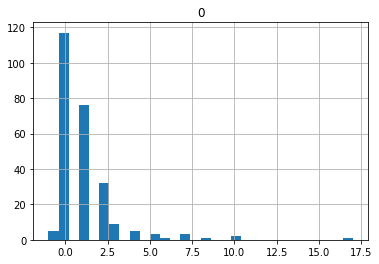

In [ ]:
import xgboost as xgb
xgb_reg = xgb.XGBRegressor(n_estimators=500, random_state=42, max_depth=4)
xgb_reg.fit(X_train, y_train)
y_pred = xgb_reg.predict(X_val)

print("training score: ", xgb_reg.score(X_train, y_train))
print("validate score: ", xgb_reg.score(X_val, y_val))
pd.DataFrame(y_pred.round()).hist(bins=30)

In [ ]:
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import KFold
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV
import warnings
warnings.filterwarnings('ignore')
# A parameter grid for Random Forest
params = {
        'max_depth': [3, 4, 5],
        'n_estimators': [200, 500]
        }

folds = 5
param_comb = 5
reg = XGBRegressor()

kf = KFold(n_splits=folds, shuffle = True, random_state = 42)

random_search = RandomizedSearchCV(reg, param_distributions=params, n_iter=param_comb, n_jobs=4, cv= kf.split(X,y+1), verbose=0, random_state=42 )

# Here we go
# start_time = timer(None) # timing starts from this point for "start_time" variable
random_search.fit(X, y+1)
# timer(start_time) # timing ends here for "start_time" variable

# print('\n All results:')
# print(random_search.cv_results_)
print('\n Best estimator:')
print(random_search.best_estimator_)
print('\n Best score:')
print(random_search.best_score_ )
print('\n Best hyperparameters:')
print(random_search.best_params_)
results = pd.DataFrame(random_search.cv_results_)

In [46]:
# TODO: Hyperparameter tuning and Model Comparison

### Prediction Visualization

In [84]:
# plot EV count Choropleth
# city: 0.0025, suburban: 0.007, rural: other
import folium

center = 47.3511, -120.7401
m = folium.Map(location=center, 
               zoom_start=7,
               width=800,height=600)
               
tmp = X_val.join(y_val)
tmp['prediction'] = y_pred

cp = folium.Choropleth(
    geo_data="../geojson/census_tract_WA_2021.geojson",
    name="city",
    data=tmp.reset_index(),
    columns=["GEOID",'prediction'],
    key_on="feature.properties.GEOID",
    fill_color="YlOrRd",
    fill_opacity=0.7,
    line_opacity=0.2,
    nan_fill_opacity=0,
    legend_name="prediction",
).add_to(m)

folium.GeoJsonTooltip(['GEOID']).add_to(cp.geojson)

m

array([[<AxesSubplot:title={'center':'0'}>]], dtype=object)

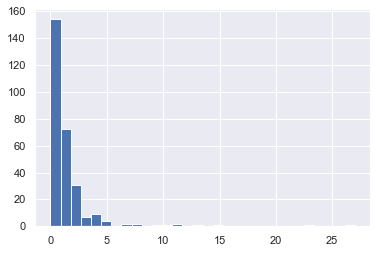

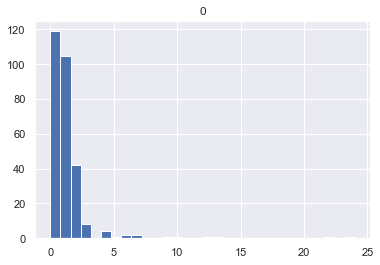

In [85]:
y_val.hist(bins=30)
pd.DataFrame(y_pred).hist(bins=30)

In [86]:
# true values visualization

center = 47.3511, -120.7401
m = folium.Map(location=center, 
               zoom_start=7,
               width=800,height=600)
               
tmp = X_val.join(y_val)
tmp['prediction'] = y_pred

cp = folium.Choropleth(
    geo_data="../geojson/census_tract_WA_2021.geojson",
    name="city",
    data=tmp.reset_index(),
    columns=["GEOID",'ev_cnt'],
    key_on="feature.properties.GEOID",
    fill_color="YlOrRd",
    fill_opacity=0.7,
    line_opacity=0.2,
    nan_fill_opacity=0,
    legend_name="true label",
).add_to(m)

folium.GeoJsonTooltip(['GEOID']).add_to(cp.geojson)

m

In [20]:
gas_points = pd.read_csv('../data/wa_gas_stations.csv')
gas_points.columns

Index(['Longitude', 'Latitude', 'name'], dtype='object')

In [35]:
# # predicted values visualization
# center = 47.3511, -120.7401
# m = folium.Map(location=center, 
#                zoom_start=7,
#                width=800,height=600)
               
# tmp = X_test.join(y_test)
# tmp['prediction'] = y_pred.astype(int)

# # draw gas stations
# # gas_points = pd.read_csv('../data/wa_gas_stations.csv')
# # for lng, lat, name in gas_points.values:
# #     label = '{}'.format(name)
# #     label = folium.Popup(label, parse_html=True)
# #     folium.Circle([lat, lng],
# #     radius=5,
# #     popup=label,
# #     color='blue',
# #     fill=True,
# #     fill_color='#3186cc',
# #     fill_opacity=0.7).add_to(m) 


# cp = folium.Choropleth(
#     geo_data="../geojson/census_tract_WA_2021.geojson",
#     name="city",
#     data=tmp.reset_index(),
#     columns=["GEOID",'prediction'],
#     key_on="feature.properties.GEOID",
#     fill_color="YlOrRd",
#     fill_opacity=0.7,
#     line_opacity=0.2,
#     nan_fill_opacity=0,
#     threshold_scale=np.linspace(0,11,10),
#     legend_name="predicted label",
# ).add_to(m)

# folium.GeoJsonTooltip(['GEOID']).add_to(cp.geojson)

# m

In [103]:
# true values visualization
center = 47.3511, -120.7401
m = folium.Map(location=center, 
               zoom_start=7,
               width=800,height=600)
               
tmp = X_test.join(y_test)
tmp['prediction'] = y_pred

cp = folium.Choropleth(
    geo_data="../geojson/census_tract_WA_2021.geojson",
    name="city",
    data=tmp.reset_index(),
    columns=["GEOID",'ev_cnt'],
    key_on="feature.properties.GEOID",
    fill_color="YlOrRd",
    fill_opacity=0.7,
    line_opacity=0.2,
    nan_fill_opacity=0,
    threshold_scale=np.linspace(0,11,10),
    legend_name="true label",
).add_to(m)

folium.GeoJsonTooltip(['GEOID']).add_to(cp.geojson)

m

ValueError: Length of values (289) does not match length of index (171)

### filtered non-zero

In [23]:
import xgboost as xgb
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import KFold
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV
import warnings
warnings.filterwarnings('ignore')
# A parameter grid for XGBoost
params = {
        'min_child_weight': [1, 5, 10],
        'gamma': [0.5, 1, 1.5, 2, 5],
        'subsample': [0.6, 0.8, 1.0],
        'colsample_bytree': [0.6, 0.8, 1.0],
        'max_depth': [3, 4, 5],
        'learning_rate':[0.1, 0.05, 0.01]
        }

folds = 5
param_comb = 5
xgb_reg = xgb.XGBRegressor(n_estimators = 500)

kf = KFold(n_splits=folds, shuffle = True, random_state = 42)

random_search = RandomizedSearchCV(xgb_reg, param_distributions=params, n_iter=param_comb, n_jobs=4, cv= kf.split(X,y), verbose=0, random_state=42 )

# Here we go
# start_time = timer(None) # timing starts from this point for "start_time" variable
random_search.fit(X, y)
# timer(start_time) # timing ends here for "start_time" variable

# print('\n All results:')
# print(random_search.cv_results_)
print('\n Best estimator:')
print(random_search.best_estimator_)
print('\n Best score:')
print(random_search.best_score_ )
print('\n Best hyperparameters:')
print(random_search.best_params_)
results = pd.DataFrame(random_search.cv_results_)

/Users/clarissarjtai/miniforge3/lib/python3.8/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index
/Users/clarissarjtai/miniforge3/lib/python3.8/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index
/Users/clarissarjtai/miniforge3/lib/python3.8/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index
/Users/clarissarjtai/miniforge3/lib/python3.8/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in


 Best estimator:
XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1.0, enable_categorical=False,
             gamma=1.5, gpu_id=-1, importance_type=None,
             interaction_constraints='', learning_rate=0.01, max_delta_step=0,
             max_depth=5, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=500, n_jobs=8,
             num_parallel_tree=1, predictor='auto', random_state=0, reg_alpha=0,
             reg_lambda=1, scale_pos_weight=1, subsample=0.6,
             tree_method='exact', validate_parameters=1, verbosity=None)

 Best score:
0.07998774827375243

 Best hyperparameters:
{'subsample': 0.6, 'min_child_weight': 1, 'max_depth': 5, 'learning_rate': 0.01, 'gamma': 1.5, 'colsample_bytree': 1.0}


In [24]:
y_pred = random_search.predict(X_val).round()
print("training set mean squared error: ", mean_squared_error(y_pred=random_search.predict(X_train), y_true=y_train).round(4))
print("validation set mean squared error: ", mean_squared_error(y_pred=y_pred, y_true=y_val).round(4))
print("training set r2_score: ", r2_score(y_pred=random_search.predict(X_train), y_true=y_train).round(4))
print("validation set r2_score: ", r2_score(y_pred=y_pred, y_true=y_val).round(4))

training set mean squared error:  1.1512
validation set mean squared error:  0.9412
training set r2_score:  0.886
validation set r2_score:  0.8845


In [25]:
# random_search.best_estimator_.save_model("xgb_best.txt")
import xgboost as xgb
model = xgb.XGBRegressor()
model.load_model('xgb_best.txt')

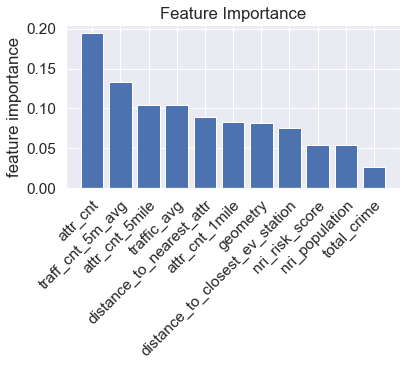

In [29]:
# model = random_search.best_estimator_
tmp = pd.DataFrame(data = model.feature_importances_, columns = ['feature_importance'], index = X_train.columns).sort_values(by='feature_importance', ascending=False)
plt.figure(figsize=(6,3))
plt.bar(x =tmp.index[:11], height = tmp.feature_importance[:11])
plt.title('Feature Importance')
plt.ylabel('feature importance')
plt.xticks(rotation = 45,rotation_mode="anchor",ha='right')
plt.show()

<AxesSubplot:>

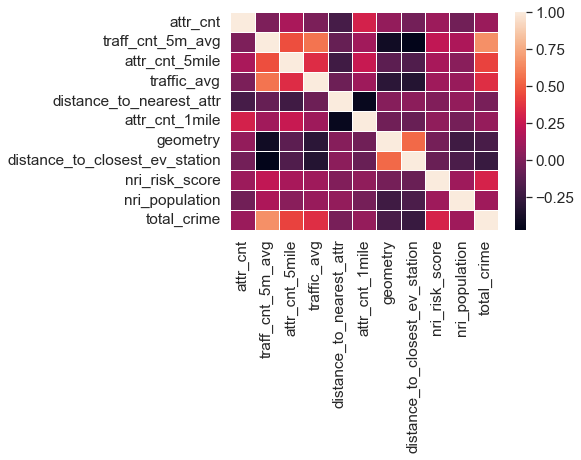

In [57]:
sns.set(font_scale=1.4)
sns.heatmap(df.loc[:,tmp.index.values].drop(columns = 'category').corr(),  linewidth=.5)

(0.0, 45.0)

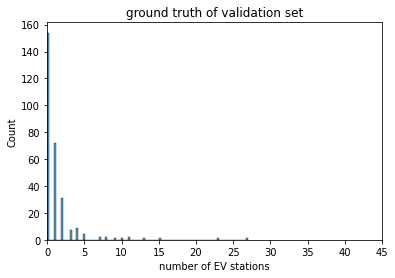

In [32]:
sns.histplot(y_val)
plt.title('ground truth of validation set')
plt.xlabel('number of EV stations')
plt.xlim(0, 45)

(0.0, 45.0)

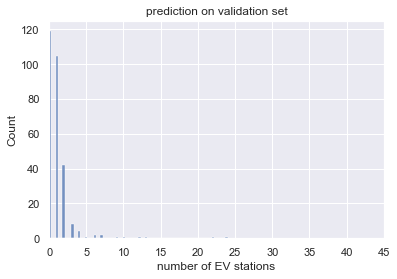

In [110]:
sns.histplot(y_pred.round())
plt.title('prediction on validation set')
plt.xlabel('number of EV stations')
plt.xlim(0, 45)

<BarContainer object of 4 artists>

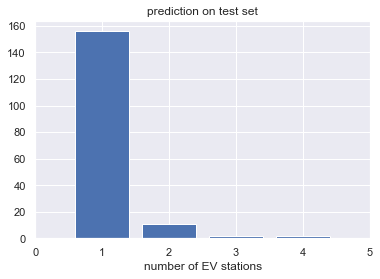

In [112]:
# Predictions on test set
y_pred_test = model.predict(X_test).round()
plt.title('prediction on test set')
plt.xlabel('number of EV stations')
plt.xlim(0, 5)
plt.bar(pd.Series(y_pred_test).value_counts().index, pd.Series(y_pred_test).value_counts().values)

In [115]:
X_test.columns

Index(['attr_cnt_1mile', 'attr_cnt_5mile', 'distance_to_nearest_attr',
       'total_crime', 'distance_to_closest_ev_station', 'nri_population',
       'nri_risk_score', 'traff_cnt_5m_avg', 'attr_cnt', 'traffic_avg',
       'geometry', 'category'],
      dtype='object')

In [132]:
# predicted values visualization
center = 47.3511, -120.7401
m = folium.Map(location=center, 
               zoom_start=7,
               width=800,height=600)

# refit on training data
# y_pred_all = model.predict(df.drop(columns=['ev_cnt','category'])).round()
# tmp = df.copy()
# tmp['ev_cnt'] = y_pred_all

# only show new predictions
tmp = X_test.join(y_test)
tmp['ev_cnt'] = y_pred_test

# concat predictions on rural area, and ground truth of training set
# tmp = pd.concat([tmp,df_train])

# tmp = df.copy()
# tmp['prediction'] = xgb_reg.predict(df.drop(columns='ev_cnt')).astype(int)

cp = folium.Choropleth(
    geo_data="../geojson/census_tract_WA_2021.geojson",
    name="city",
    data=tmp.reset_index(),
    columns=["GEOID",'ev_cnt'],
    key_on="feature.properties.GEOID",
    fill_color="YlOrRd",
    fill_opacity=0.7,
    line_opacity=0.3,
    # nan_fill_color='Yellow',
    nan_fill_opacity = 0,
    threshold_scale=[0, 1, 2, 3, 4, 5, max(df.ev_cnt)],
    legend_name="true label",
).add_to(m)


folium.GeoJsonTooltip(['GEOID']).add_to(cp.geojson)

m

In [131]:
# true values visualization
center = 47.3511, -120.7401
m = folium.Map(location=center, 
               zoom_start=7,
               width=800,height=600)
               

cp = folium.Choropleth(
    geo_data="../geojson/census_tract_WA_2021.geojson",
    name="city",
    data=df.reset_index(),
    columns=["GEOID",'ev_cnt'],
    key_on="feature.properties.GEOID",
    fill_color="YlOrRd",
    fill_opacity=0.7,
    line_opacity=0.2,
    nan_fill_opacity=0,
    threshold_scale=[0, 1, 2, 3, 4, 5, max(df.ev_cnt)],
    legend_name="true label",
).add_to(m)

folium.GeoJsonTooltip(['GEOID']).add_to(cp.geojson)

m